<a href="https://colab.research.google.com/github/anvichip/haarcascade-facial-features/blob/main/facial_features.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [2]:
#!kaggle datasets download arnaud58/flickrfaceshq-dataset-ffhq

In [3]:
#alt tommykamaz/faces-dataset-small
!kaggle datasets download tommykamaz/faces-dataset-small

100% 3.98G/3.99G [00:46<00:00, 89.6MB/s]
100% 3.99G/3.99G [00:46<00:00, 92.4MB/s]


In [4]:
!unzip /content/faces-dataset-small.zip

Archive:  /content/faces-dataset-small.zip
  inflating: faces_dataset_small/00055.png  
  inflating: faces_dataset_small/00237.png  
  inflating: faces_dataset_small/00240.png  
  inflating: faces_dataset_small/00241.png  
  inflating: faces_dataset_small/00242.png  
  inflating: faces_dataset_small/00243.png  
  inflating: faces_dataset_small/00244.png  
  inflating: faces_dataset_small/00245.png  
  inflating: faces_dataset_small/00246.png  
  inflating: faces_dataset_small/00247.png  
  inflating: faces_dataset_small/00248.png  
  inflating: faces_dataset_small/00249.png  
  inflating: faces_dataset_small/00253.png  
  inflating: faces_dataset_small/00255.png  
  inflating: faces_dataset_small/00257.png  
  inflating: faces_dataset_small/00258.png  
  inflating: faces_dataset_small/00259.png  
  inflating: faces_dataset_small/00260.png  
  inflating: faces_dataset_small/00261.png  
  inflating: faces_dataset_small/00262.png  
  inflating: faces_dataset_small/00263.png  
  inflating:

In [5]:
#!unzip /content/flickrfaceshq-dataset-ffhq.zip

In [25]:
import cv2
from google.colab.patches import cv2_imshow

def detect_eyes_and_mouth(image_path):
    # Read the input image
    img = cv2.imread(image_path)

    # Convert the image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Load the face cascade classifier
    face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

    # Load the eye cascade classifier
    eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')

    # Load the mouth cascade classifier
    mouth_cascade = cv2.CascadeClassifier('/content/haarcascade_mcs_mouth (1).xml')

    # Detect faces
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.3, minNeighbors=5)

    # Check if a face is detected
    if len(faces) == 0:
      cv2_imshow(img)
      print("No face detected.")
      return

    # Loop over the detected faces
    for (x, y, w, h) in faces:
        roi_gray = gray[y:y+h, x:x+w]
        roi_color = img[y:y+h, x:x+w]

        # Detect eyes within the face ROI
        eyes = eye_cascade.detectMultiScale(
            roi_gray,
            minNeighbors=10,
            minSize=(50, 50)
        )

        # Initialize a list to store the non-overlapping mouth detections
        non_overlapping_mouths = []

        # Detect mouths within the face ROI
        mouths = mouth_cascade.detectMultiScale(
            roi_gray,
            minNeighbors=10,
            minSize=(100, 100),
        )

        # Sort the mouth detections based on area (largest to smallest)
        mouths = sorted(mouths, key=lambda x: x[2] * x[3], reverse=True)
        eyes = sorted(eyes, key=lambda x: x[2] * x[3], reverse=True)[:2]
        # Check for overlapping between mouth and eye detections
        for (mx, my, mw, mh) in mouths:
            mouth_overlaps = False

            # Check for overlapping with each eye detection
            for (ex, ey, ew, eh) in eyes:
                if (mx + mw >= ex and ex + ew >= mx and my + mh >= ey and ey + eh >= my):
                    mouth_overlaps = True
                    break

            # If there is no overlapping with any eye detection, add the mouth detection to the non-overlapping list
            if not mouth_overlaps:
                non_overlapping_mouths.append((mx, my, mw, mh))

        # Draw rectangles around the eye regions
        for (ex, ey, ew, eh) in eyes:
            cv2.rectangle(roi_color, (ex, ey), (ex+ew, ey+eh), (0, 255, 255), 2)

        # Draw rectangle around the largest non-overlapping mouth
        if non_overlapping_mouths:
            (mx, my, mw, mh) = non_overlapping_mouths[0]
            cv2.rectangle(roi_color, (mx, my), (mx+mw, my+mh), (255, 0, 0), 2)

    # Display the image with detected eyes and mouth
    cv2_imshow(img)
    print(image_path)
    print("eyes coordinates:" + str(eyes))
    print("mouth coordinates:" + str(non_overlapping_mouths))
    cv2.waitKey(0)
    cv2.destroyAllWindows()


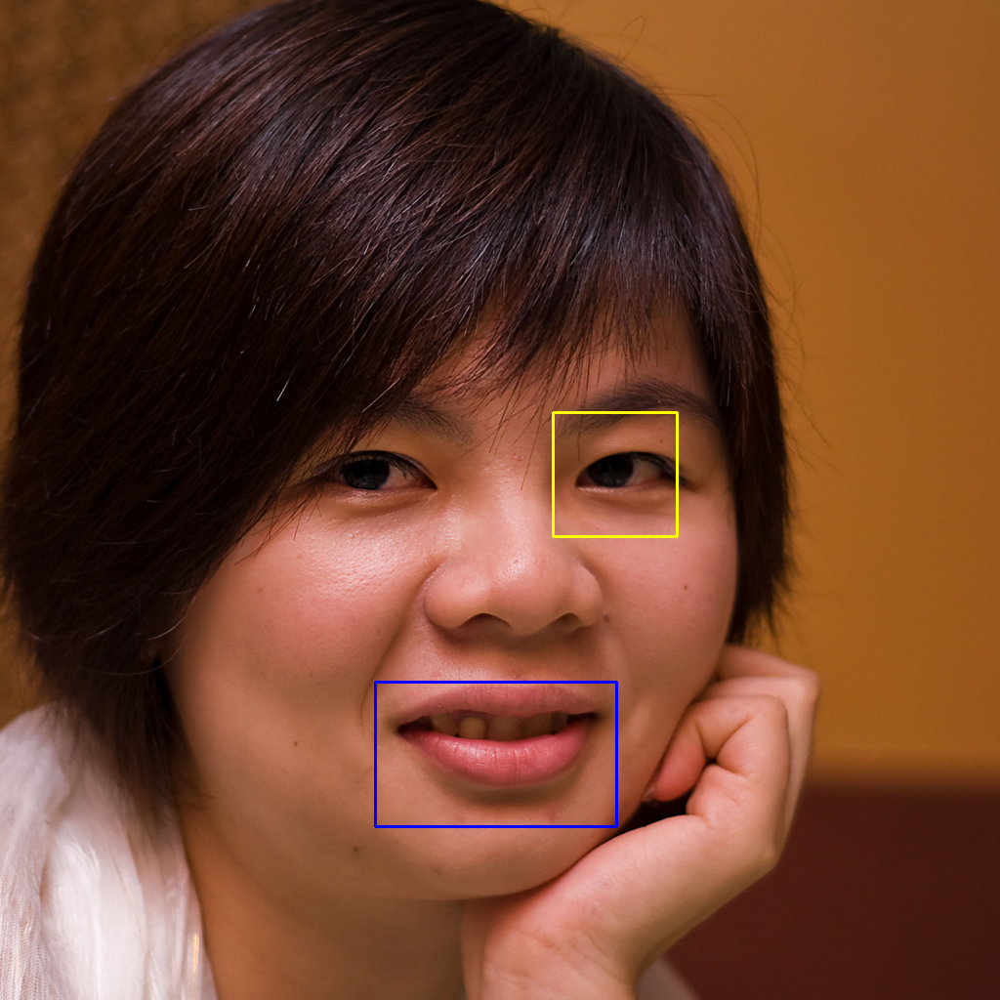

/content/images/01760.png
eyes coordinates:[array([382, 199, 127, 127], dtype=int32)]
mouth coordinates:[(200, 475, 247, 148)]


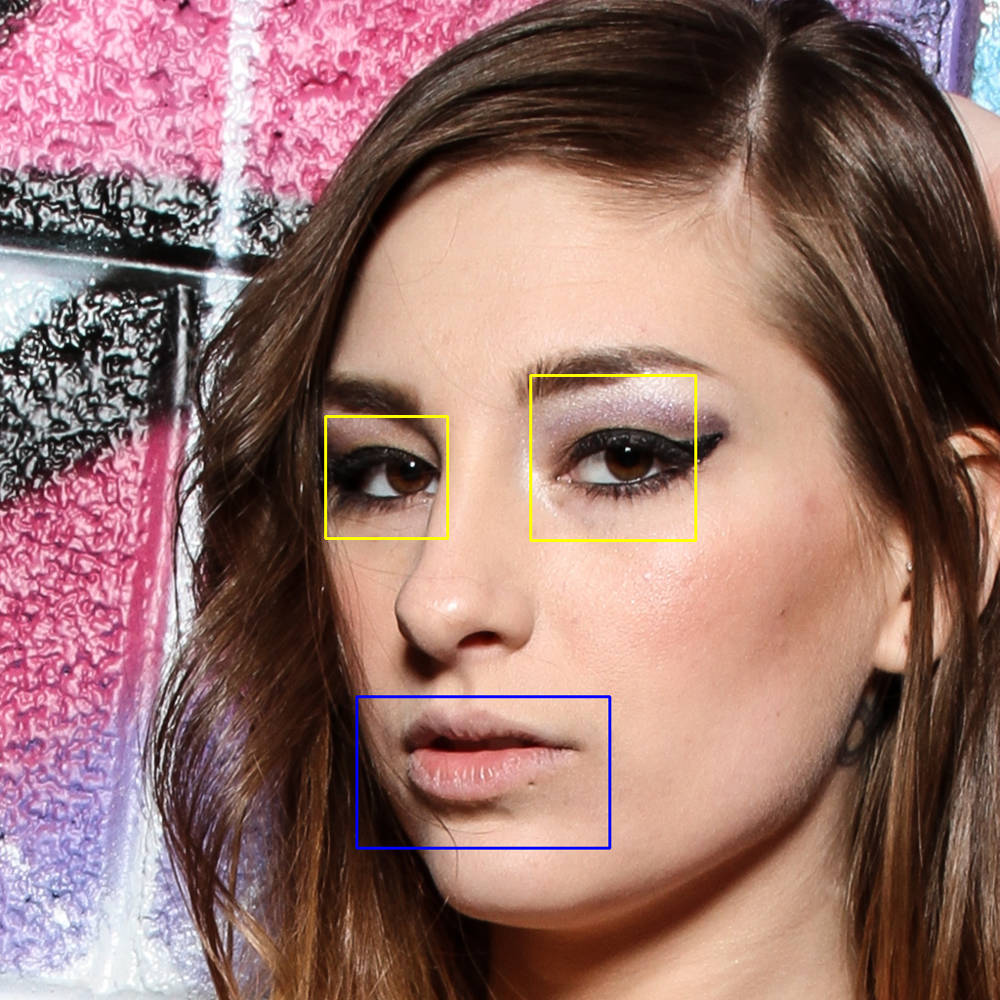

/content/images/01761.png
eyes coordinates:[array([378, 191, 169, 169], dtype=int32), array([168, 233, 125, 125], dtype=int32)]
mouth coordinates:[(200, 520, 259, 155)]


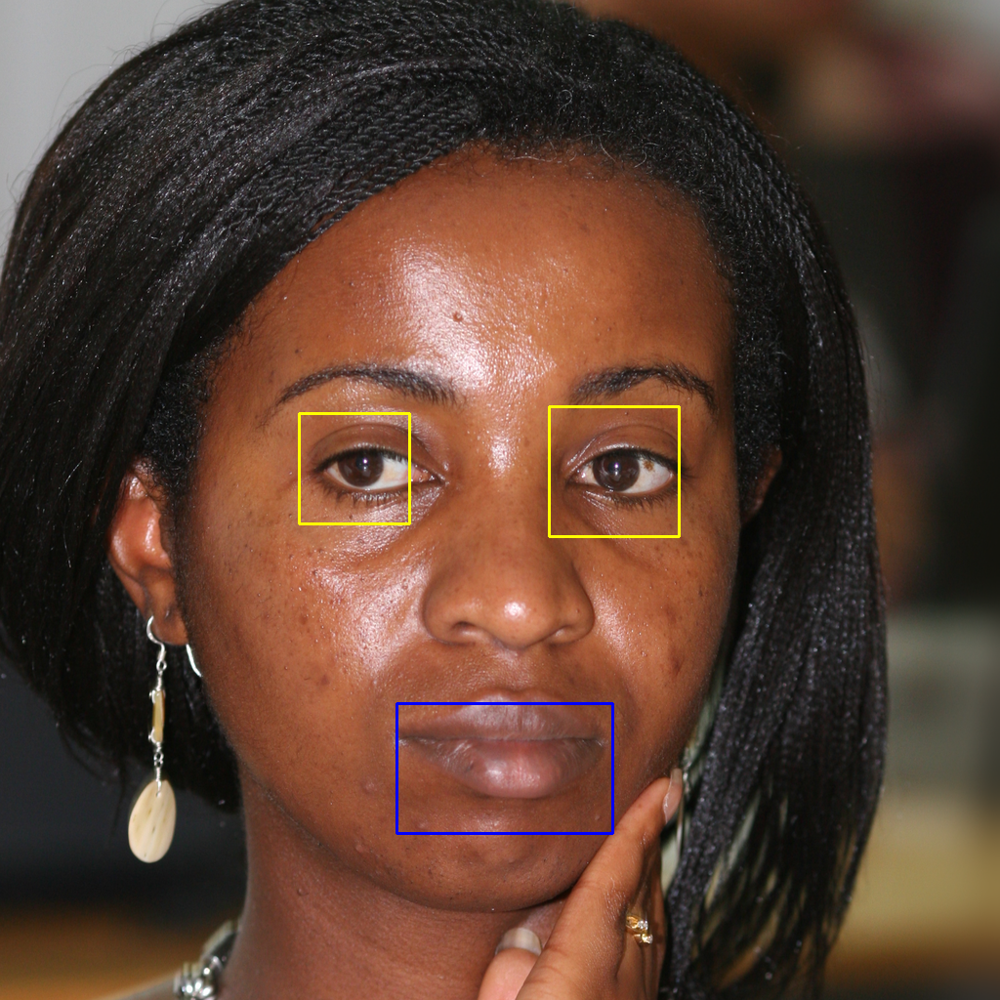

/content/images/01753.png
eyes coordinates:[array([367, 177, 133, 133], dtype=int32), array([111, 184, 113, 113], dtype=int32)]
mouth coordinates:[(211, 481, 221, 133)]


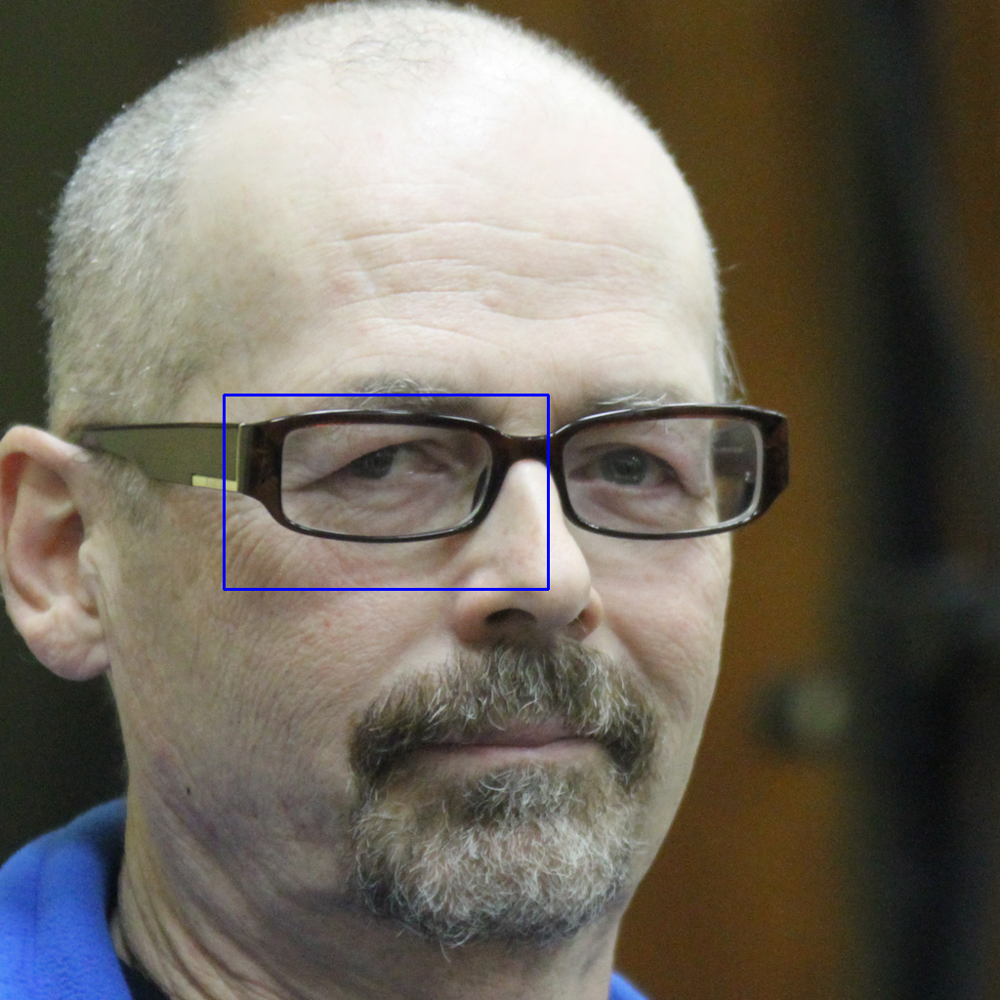

/content/images/01756.png
eyes coordinates:[]
mouth coordinates:[(52, 202, 332, 199), (209, 515, 277, 166), (128, 308, 182, 110)]


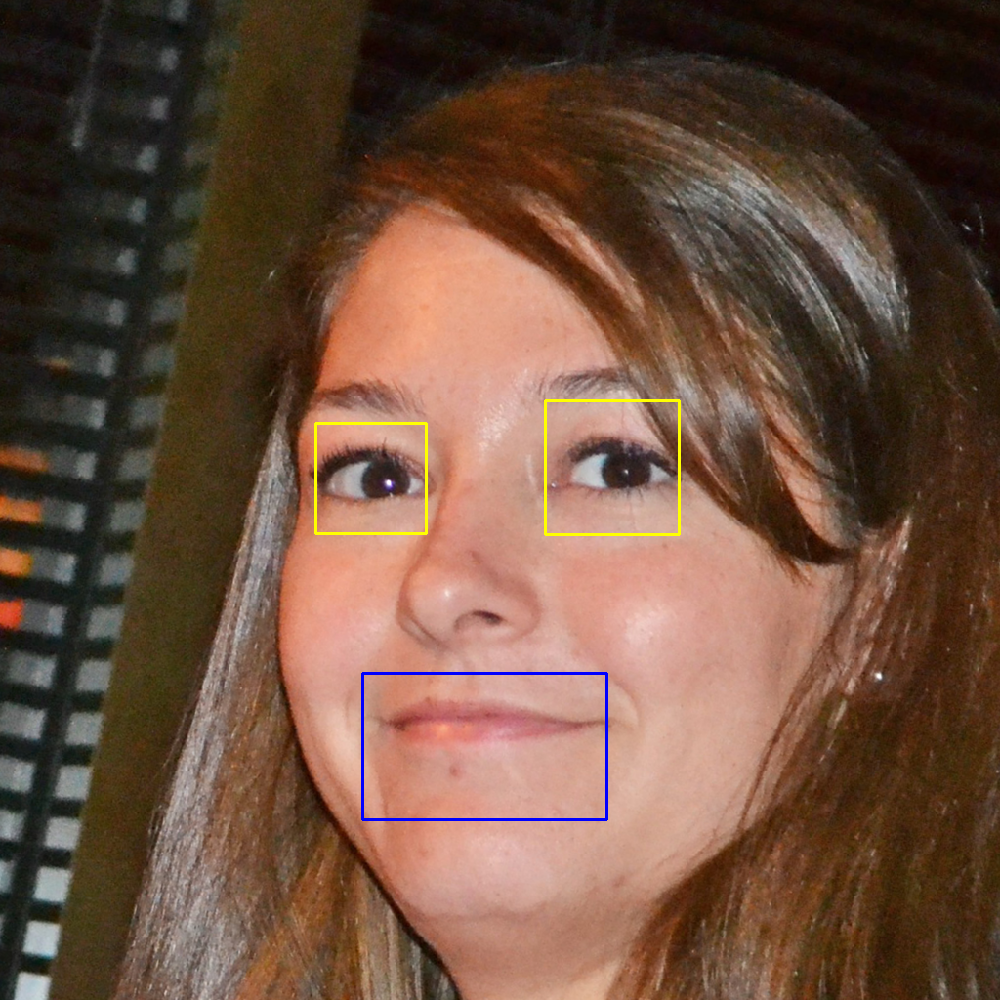

/content/images/01723.png
eyes coordinates:[array([367, 157, 137, 137], dtype=int32), array([132, 180, 113, 113], dtype=int32)]
mouth coordinates:[(180, 436, 250, 150)]


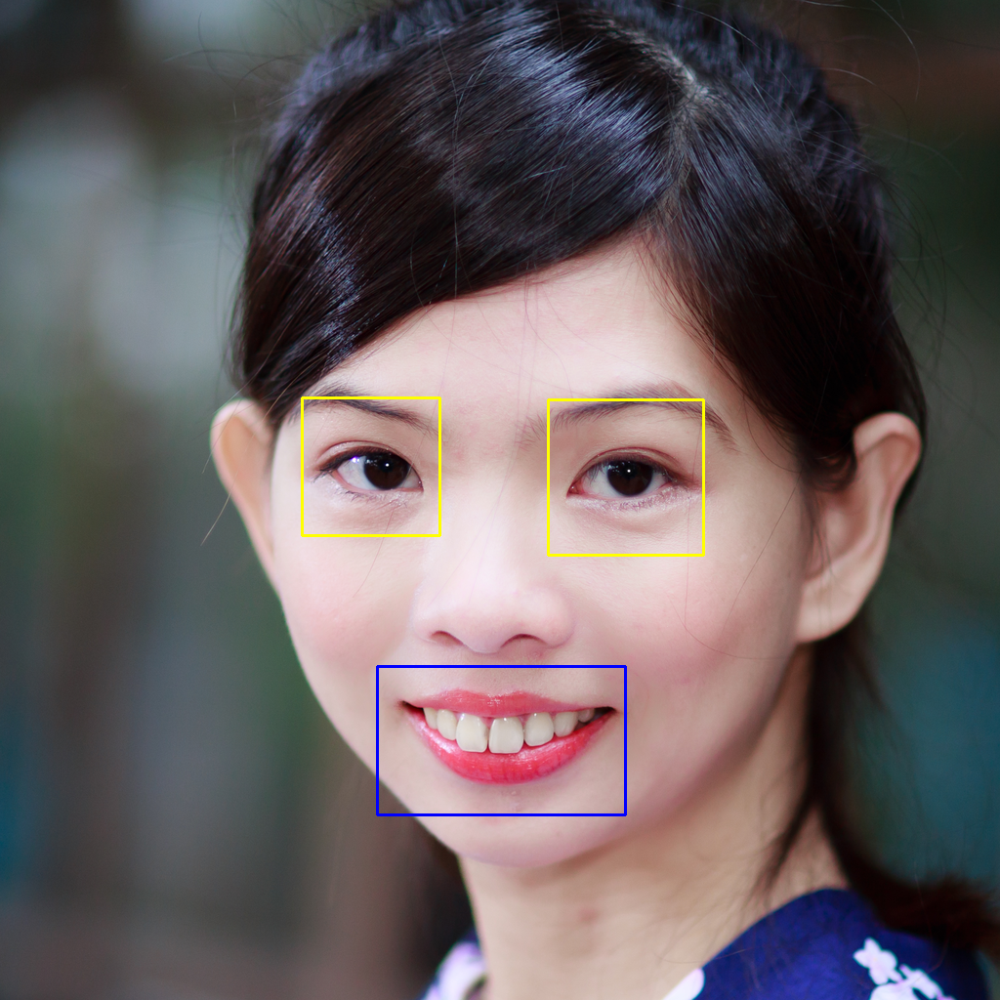

/content/images/01752.png
eyes coordinates:[array([368, 174, 159, 159], dtype=int32), array([116, 172, 141, 141], dtype=int32)]
mouth coordinates:[(193, 447, 254, 152)]


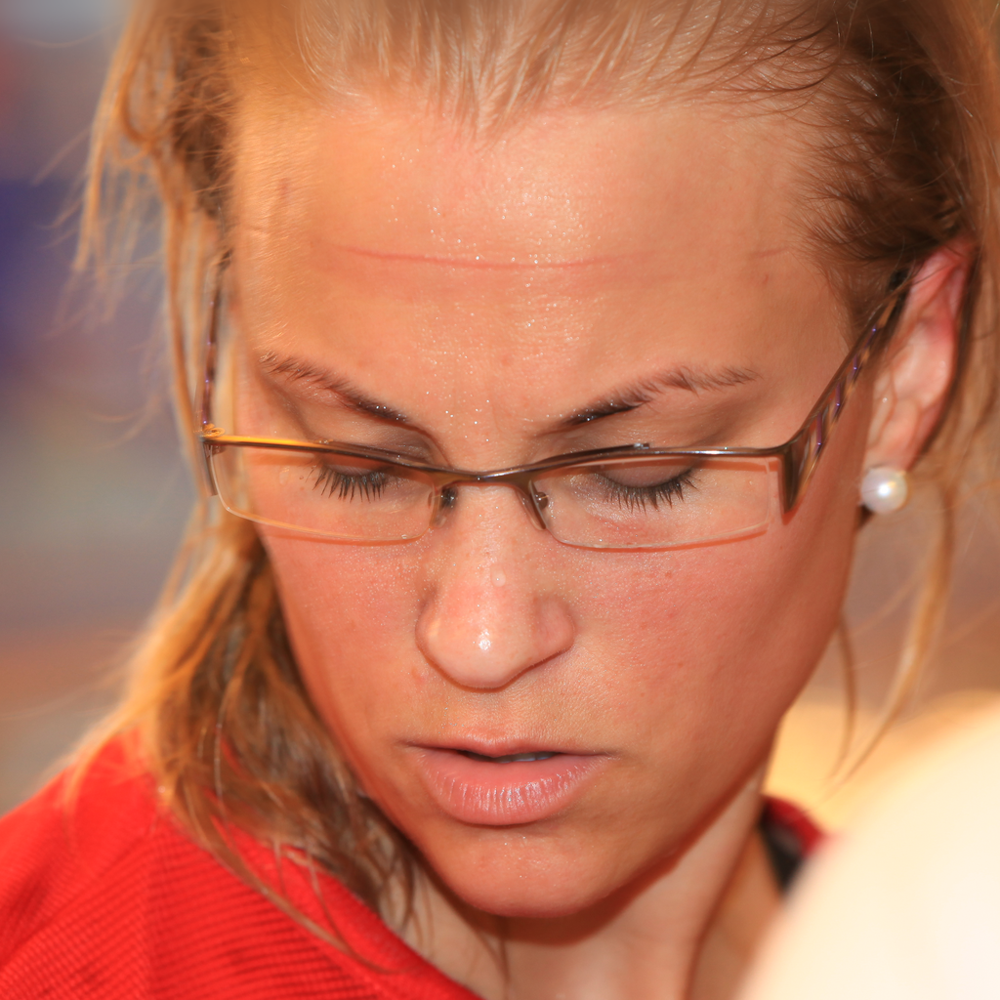

No face detected.


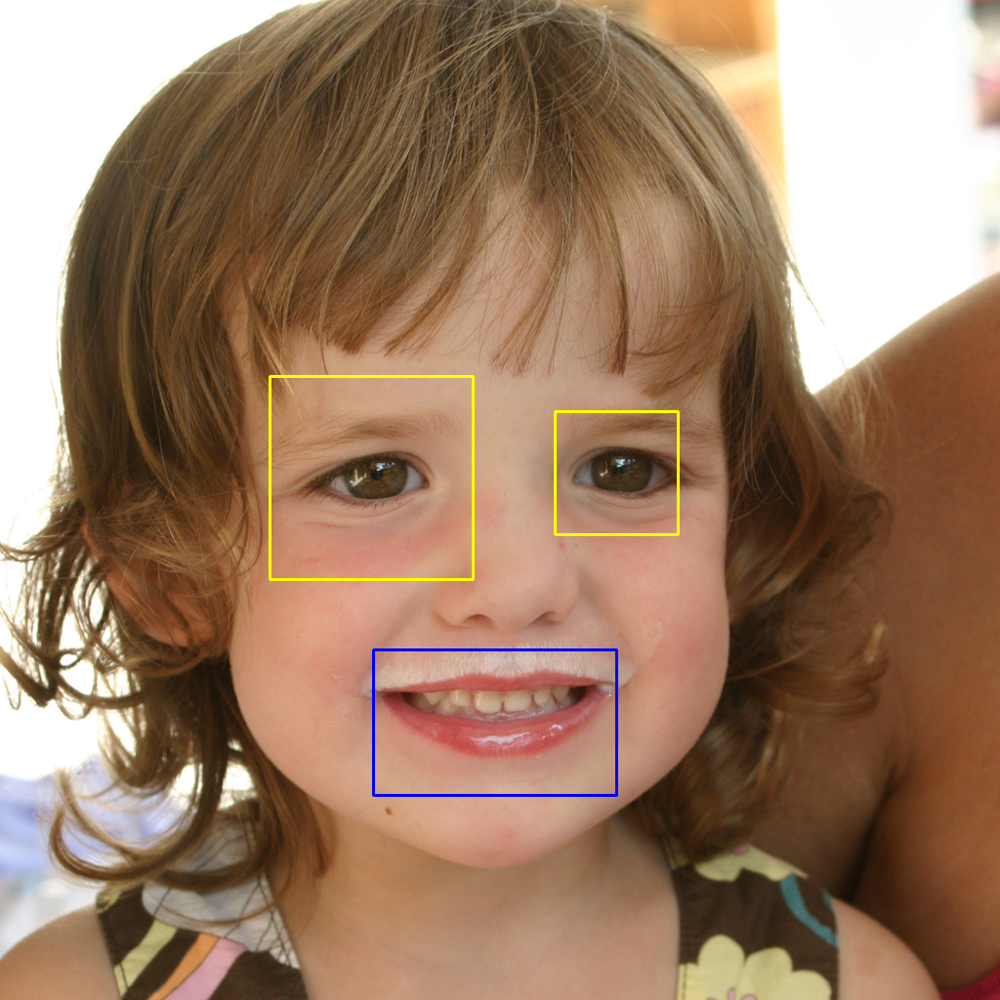

/content/images/01751.png
eyes coordinates:[array([ 99, 138, 208, 208], dtype=int32), array([391, 174, 126, 126], dtype=int32)]
mouth coordinates:[(205, 418, 249, 149)]


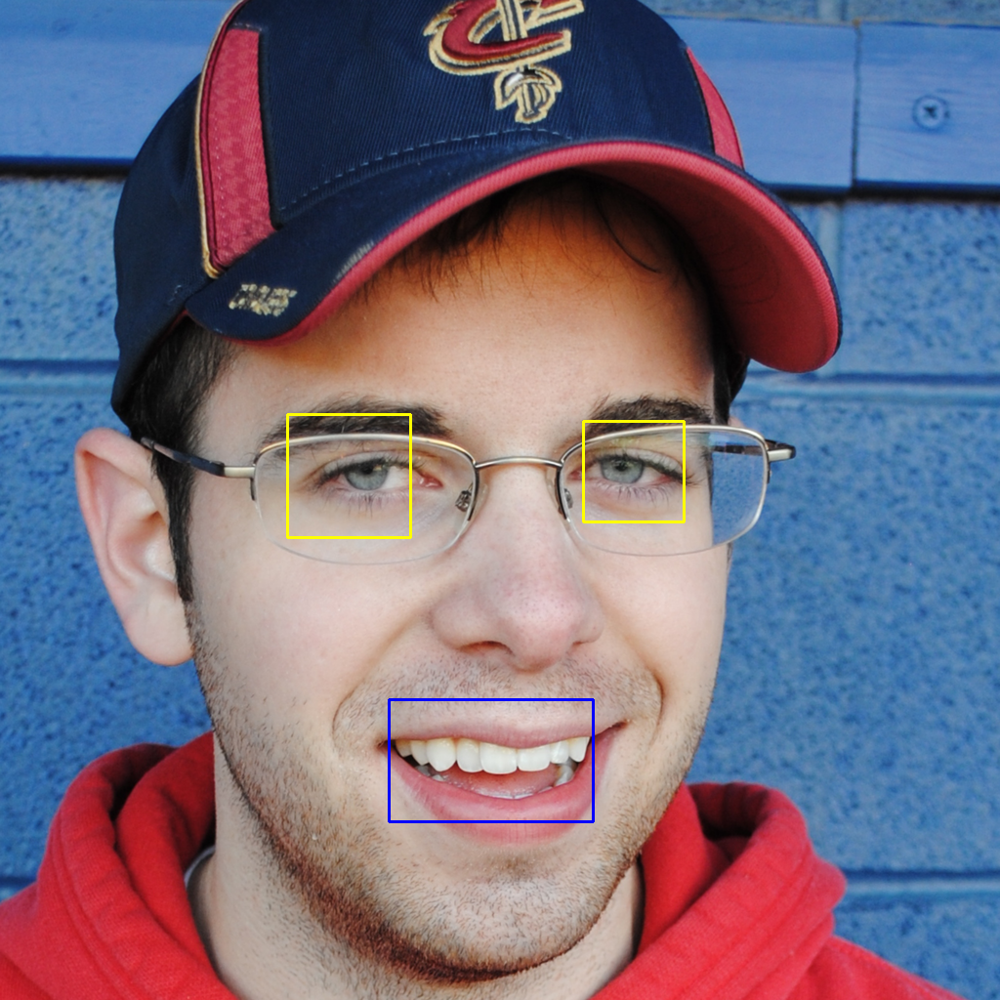

/content/images/01759.png
eyes coordinates:[array([ 59, 153, 126, 126], dtype=int32), array([362, 160, 103, 103], dtype=int32)]
mouth coordinates:[(163, 445, 209, 125)]


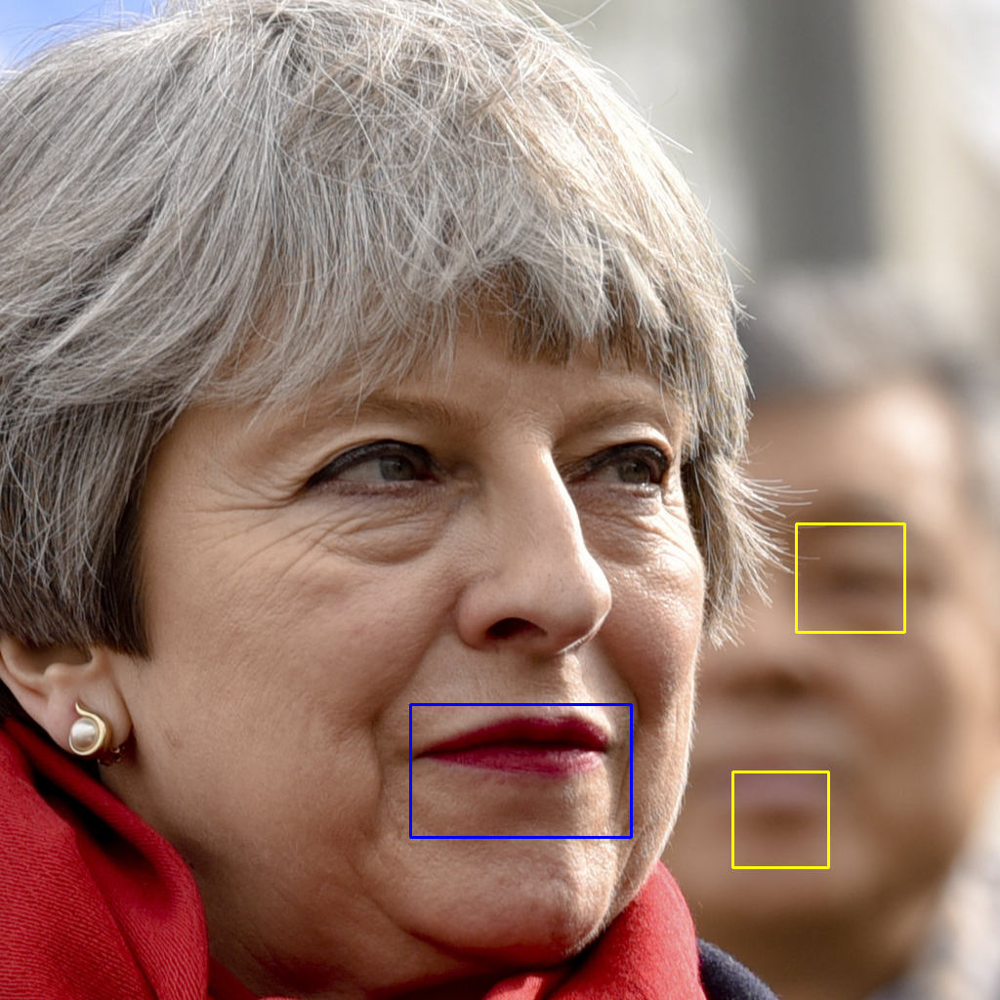

/content/images/01750.png
eyes coordinates:[array([682, 387, 111, 111], dtype=int32), array([617, 641,  98,  98], dtype=int32)]
mouth coordinates:[(287, 572, 226, 136), (147, 310, 217, 130)]


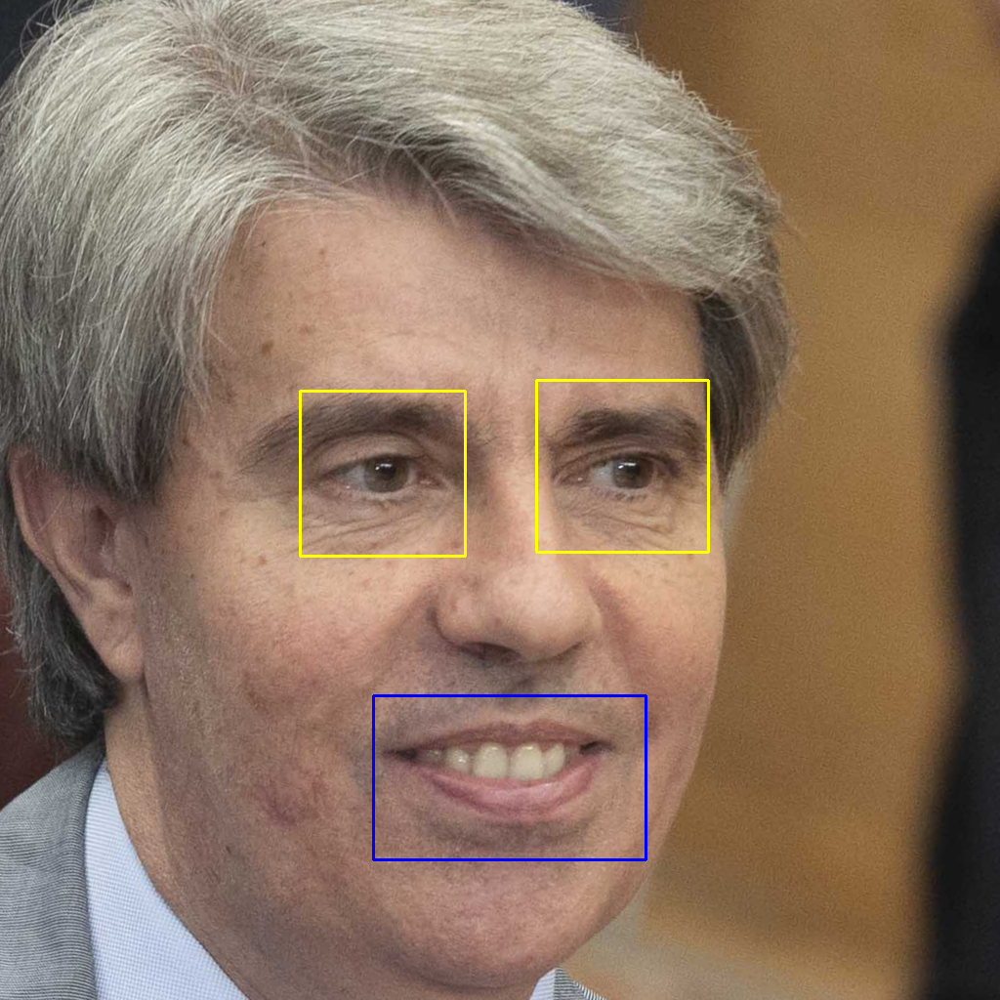

/content/images/01766.png
eyes coordinates:[array([385, 176, 176, 176], dtype=int32), array([143, 187, 169, 169], dtype=int32)]
mouth coordinates:[(218, 499, 279, 168)]


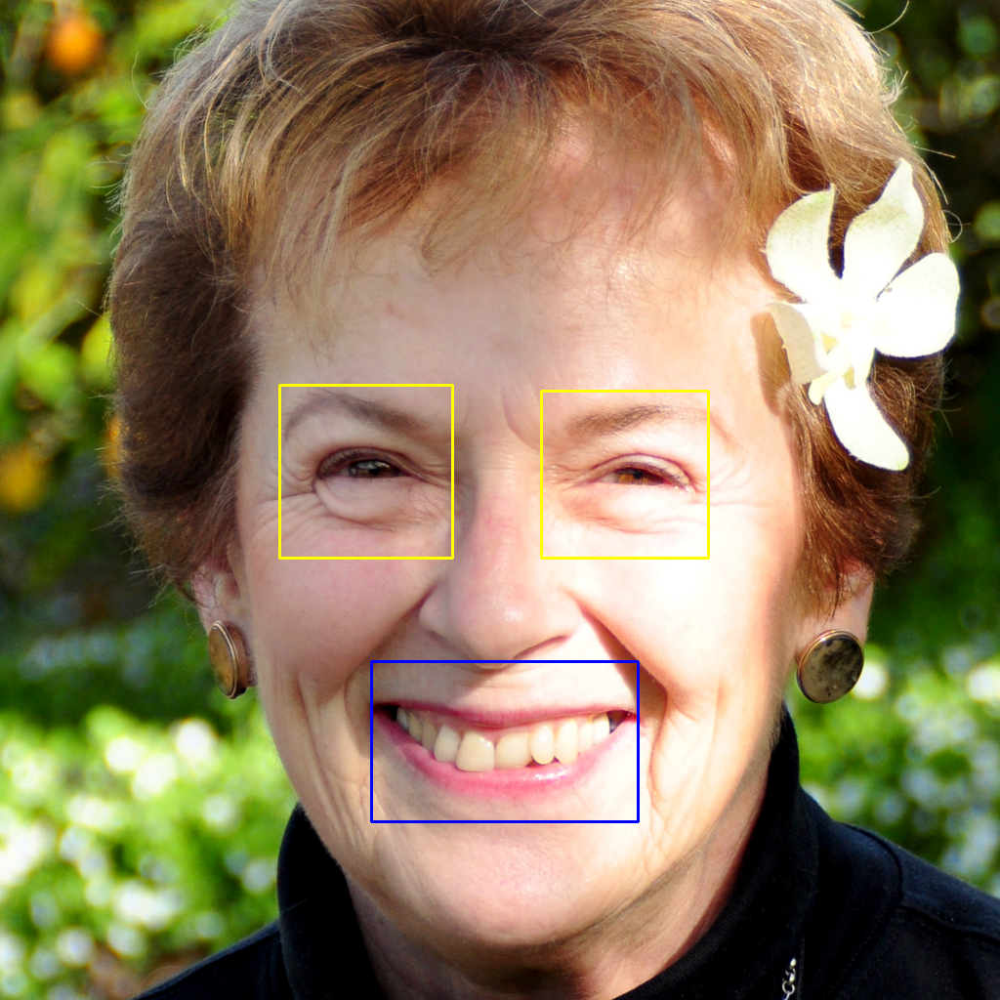

/content/images/01764.png
eyes coordinates:[array([ 91, 166, 177, 177], dtype=int32), array([359, 172, 171, 171], dtype=int32)]
mouth coordinates:[(185, 449, 273, 164)]


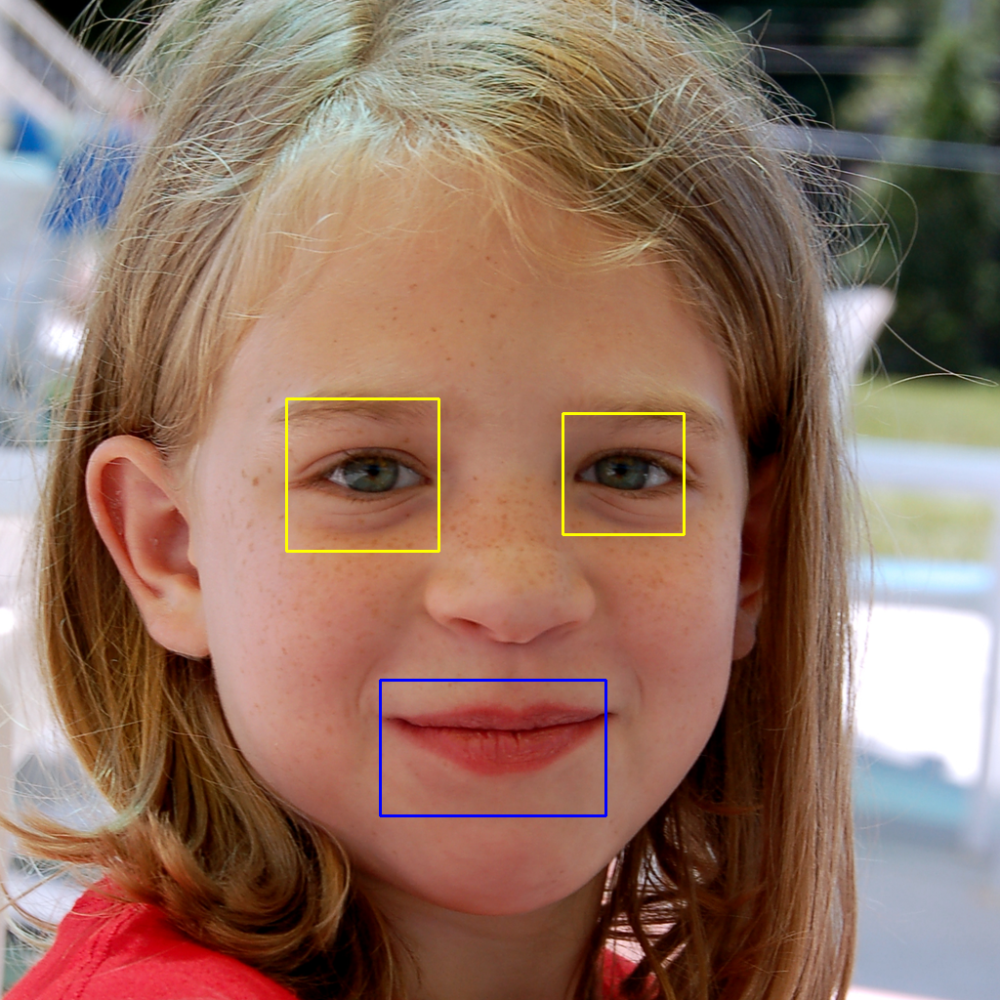

/content/images/01762.png
eyes coordinates:[array([118, 181, 156, 156], dtype=int32), array([401, 196, 124, 124], dtype=int32)]
mouth coordinates:[(214, 469, 231, 139)]


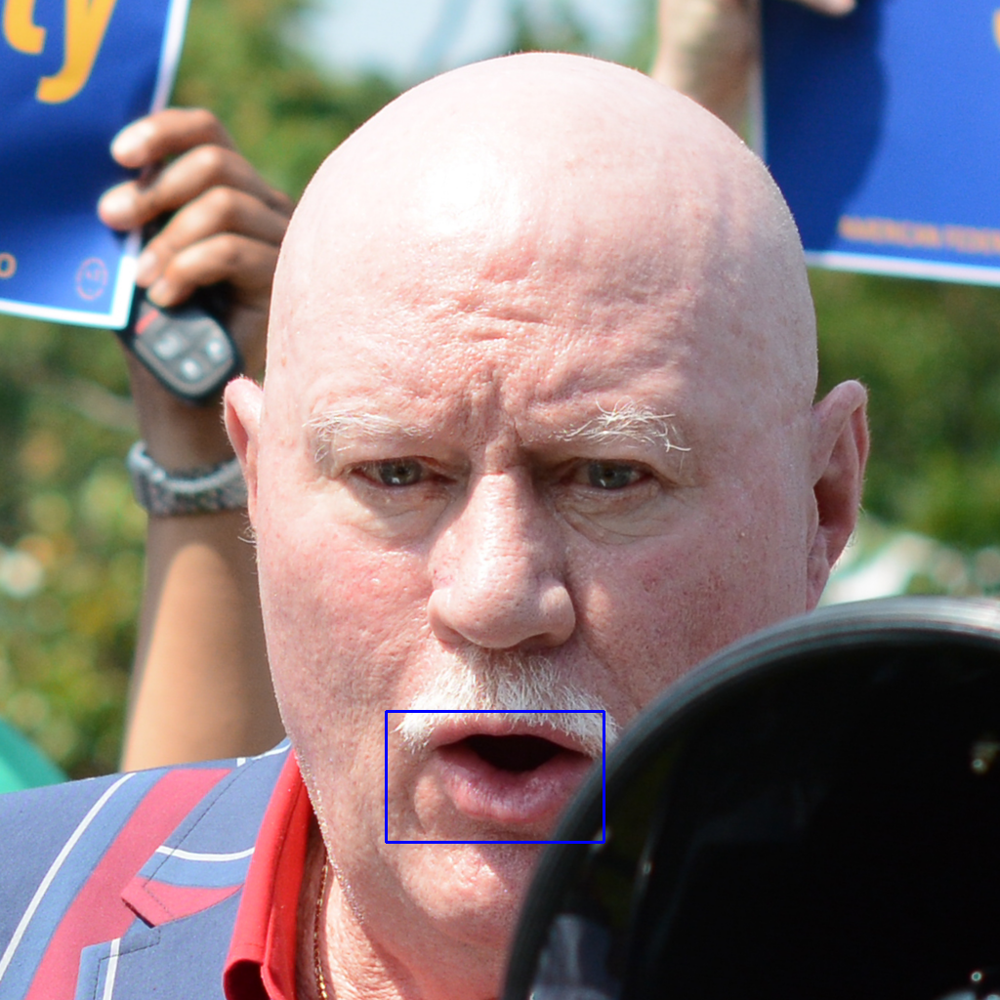

/content/images/01724.png
eyes coordinates:[]
mouth coordinates:[(185, 467, 223, 134), (105, 181, 199, 119)]


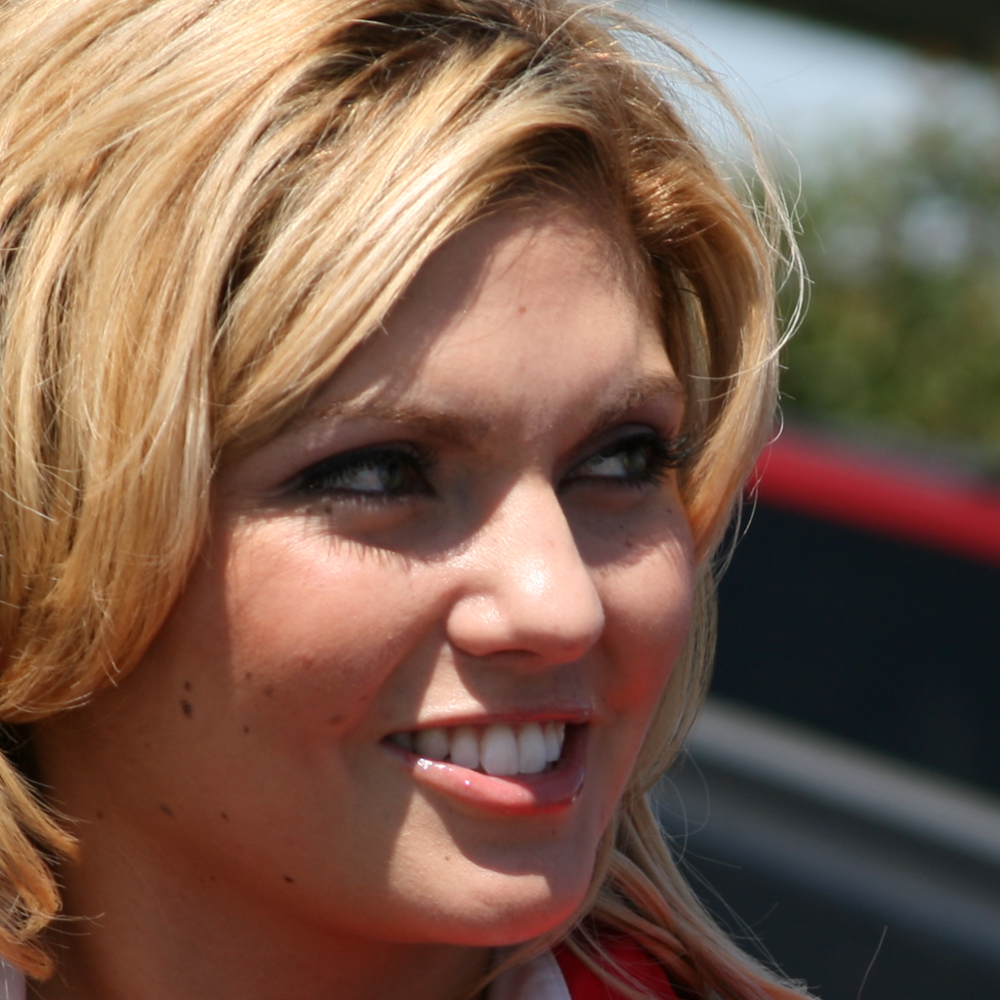

No face detected.


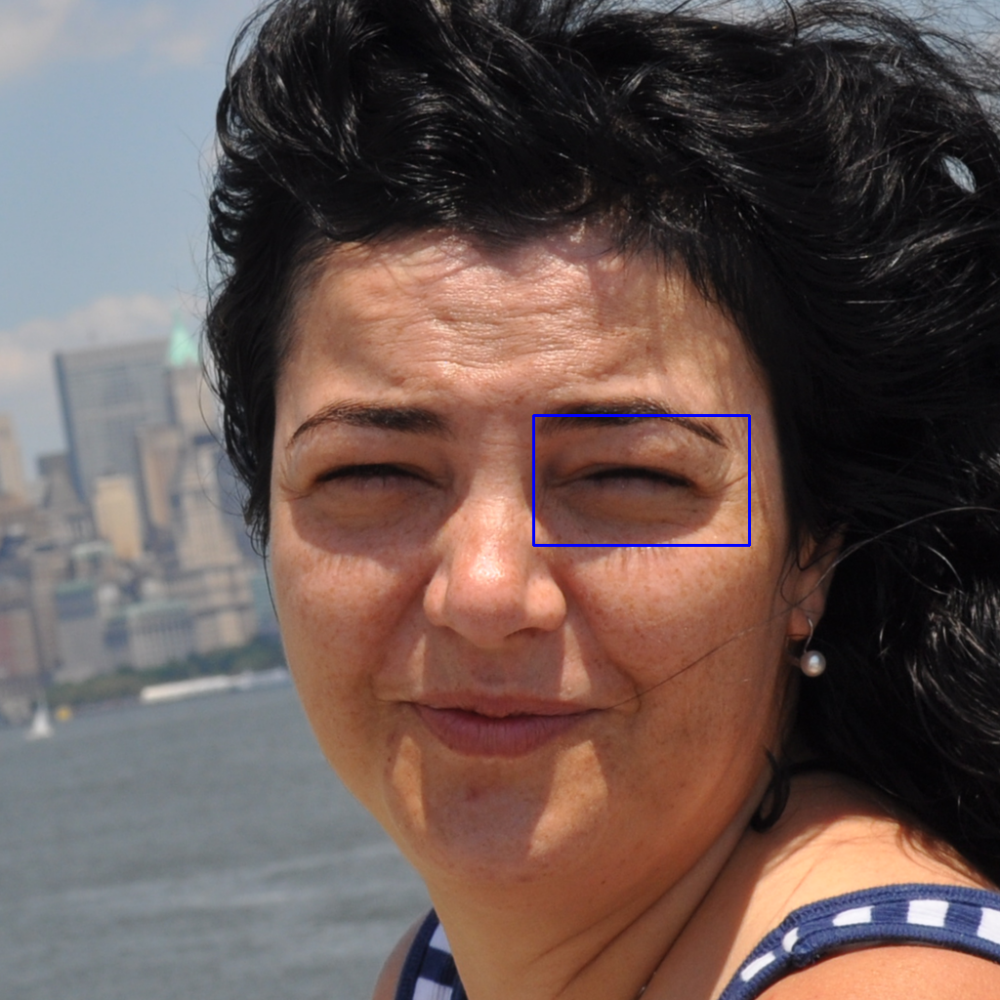

/content/images/01722.png
eyes coordinates:[]
mouth coordinates:[(380, 206, 221, 133), (239, 474, 214, 128), (115, 203, 210, 126)]


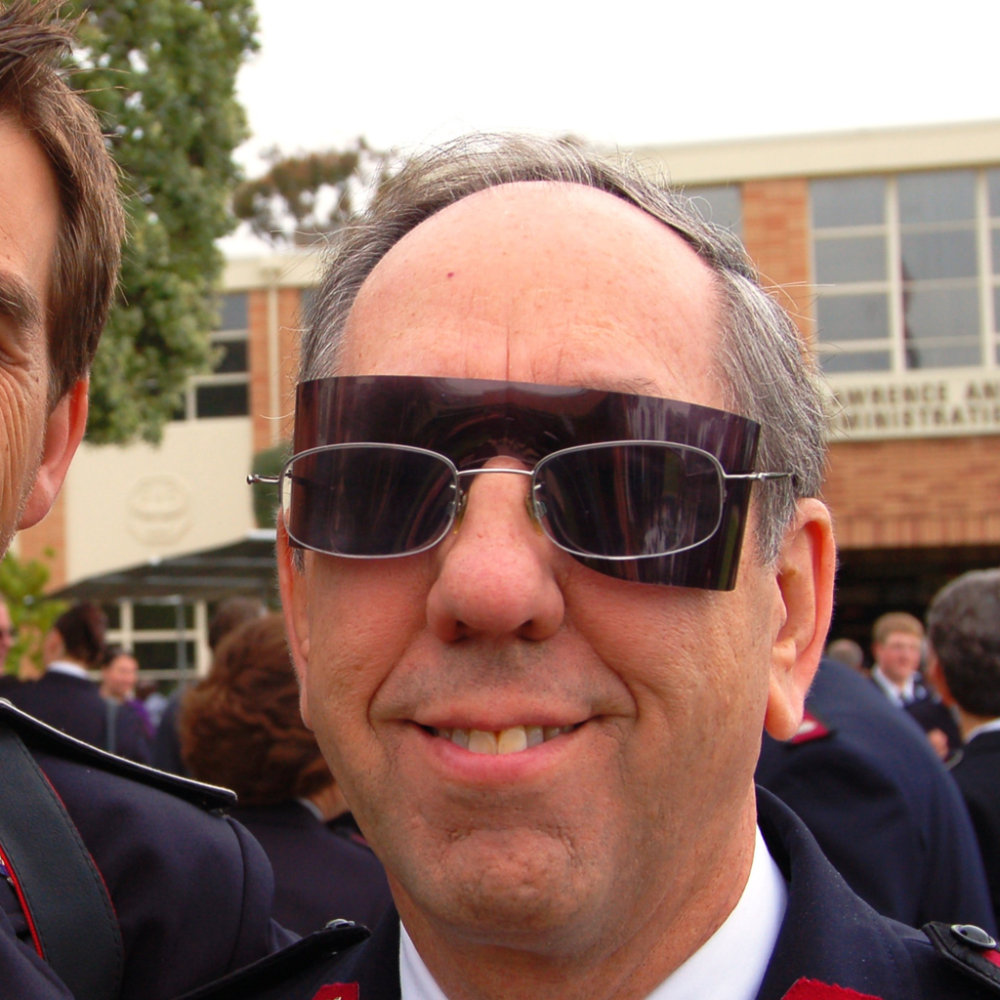

No face detected.


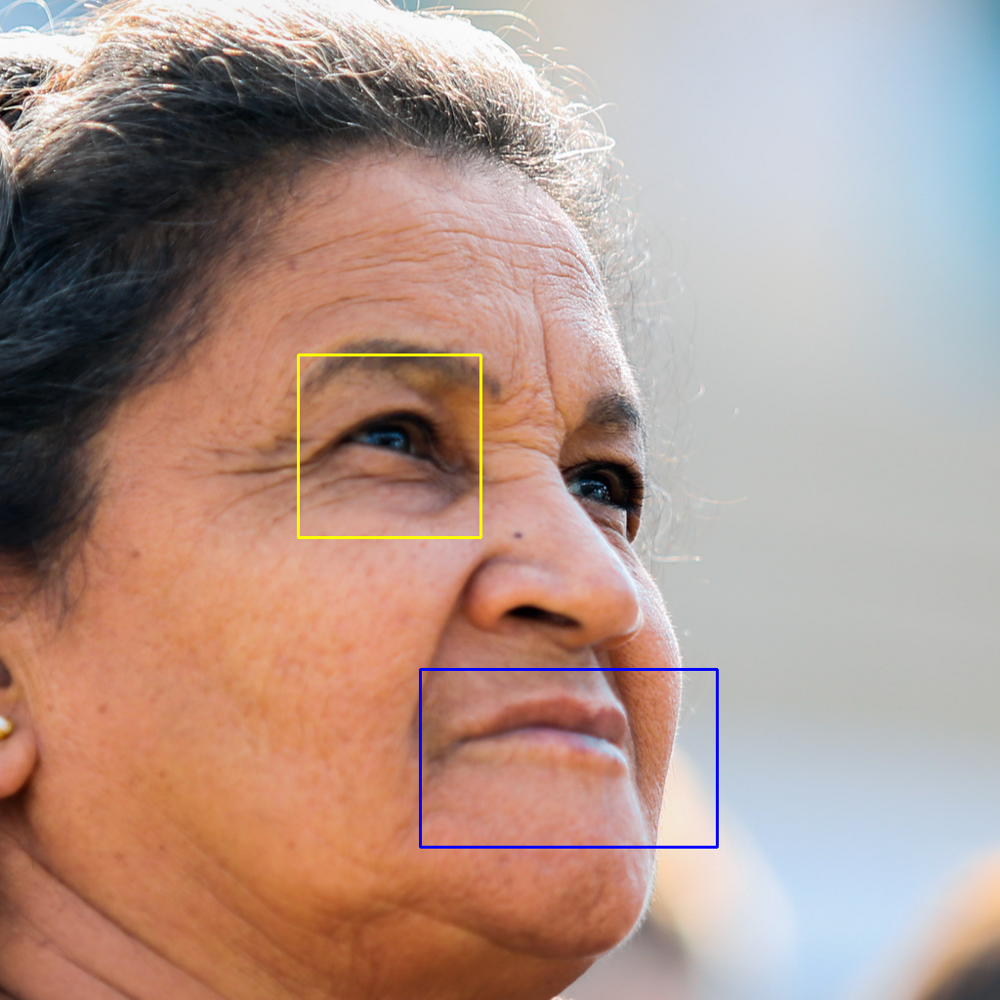

/content/images/01721.png
eyes coordinates:[array([139, 166, 187, 187], dtype=int32)]
mouth coordinates:[(264, 488, 304, 182)]


In [26]:
import os

directory = os.listdir('/content/images')

for image in directory:
    image_path = os.path.join('/content/images', image)
    detect_eyes_and_mouth(image_path)
